### Notebook to render the scene

In [119]:
import os

cwd = os.getcwd()
mitsuba_file = cwd + "/mitsubas/scenariosO/scenario000/modern_export.xml"
# Original Meshes Path
original_meshes_path = cwd + "/mitsubas/scenarios/scenario000/meshes"

In [2]:
gpu_num = "" # Use "" to use the CPU
os.environ["CUDA_VISIBLE_DEVICES"] = f"{gpu_num}"
import tensorflow as tf
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
    except RuntimeError as e:
        print(e) # Avoid warnings from TensorFlow
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

tf.random.set_seed(1) # Set global random seed for reproducibility

2024-10-24 12:56:26.587511: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-10-24 12:56:26.709104: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2024-10-24 12:56:26.709122: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2024-10-24 12:56:26.733633: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-24 12:56:27.277434: W tensorflow/stream_executor/platform/de

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import time
import sionna
import pymeshlab.pmeshlab
from pymeshlab.pmeshlab import MeshSet
from utils.utils import get_center_of_vertice_pos
import tqdm

# Import Sionna RT components
from sionna.rt import load_scene, Transmitter, Receiver, PlanarArray, Camera, RadioMaterial

In [6]:
# Load integrated scene  # talvez usar isso ao inves do RT duration
scene = load_scene(mitsuba_file) 

In [8]:
scene.remove('tx')
scene.remove('rx')

custom_material_asphalt = RadioMaterial("asphalt" , 5.72 , 5e-4)  
scene.add(custom_material_asphalt)

In [126]:
len_path = 0
while(len_path < 10 or len_path > 1000):
    ################################# Configure Rx mobility parameters #############
    scene.remove('tx')
    scene.remove('rx')
    scene.remove('cam')

    # Modern City coordinates
    lim_sup_esq = (-105.4, 91)
    lim_sup_dir = (78.5, 91)
    lim_inf_esq = (-105.4, -106)
    lim_inf_dir = (78.5, -106)

    # Higher Rx and Tx Z
    tx_x = []
    tx_y = []
    tx_z = []
    higher_rx_z_1 = 10
    higher_rx_z_2 = 0
    higher_tx_z = 0
    threshold = 2.5

    gd = 50
    j = 0
    k = 0

    grid_x_start_stop = ((j*gd)+ lim_sup_esq[0], ((j+1)*gd) + lim_sup_esq[0])
    grid_y_start_stop = (lim_sup_esq[1] - (k*gd), lim_sup_esq[1] - ((k+1)*gd))

    # Coordenadas aleatorias no cenario
    random_x_1 = np.random.uniform(grid_x_start_stop[0], grid_x_start_stop[1])
    random_y_1 = np.random.uniform(grid_y_start_stop[0], grid_y_start_stop[1])
    random_x_2 = np.random.uniform(grid_x_start_stop[0], grid_x_start_stop[1])
    random_y_2 = np.random.uniform(grid_y_start_stop[0], grid_y_start_stop[1])

    # Create a meshset
    ms = pymeshlab.pmeshlab.MeshSet()

    for m in os.listdir(original_meshes_path):
        # Load the mesh
        ms.load_new_mesh(os.path.join(original_meshes_path, m))
        cm = ms.current_mesh()
        # Position of the object
        vertice_pos = get_center_of_vertice_pos(cm.vertex_matrix())
        if vertice_pos[2] >= higher_tx_z:
            tx_x.append(vertice_pos[0])
            tx_y.append(vertice_pos[1])
            tx_z.append(vertice_pos[2])
            higher_tx_z = vertice_pos[2]

        # Rx 1 Z
        if (vertice_pos[0] >= random_x_1 - threshold and vertice_pos[0] <= random_x_1 + threshold) and (vertice_pos[1] >= random_y_1 - threshold and vertice_pos[1] <= random_y_1 + threshold):
            if vertice_pos[2] > higher_rx_z_1:
                higher_rx_z_1 = vertice_pos[2]
        # Rx 2 Z
        if (vertice_pos[0] >= random_x_2 - threshold and vertice_pos[0] <= random_x_2 + threshold) and (vertice_pos[1] >= random_y_2 - threshold and vertice_pos[1] <= random_y_2 + threshold):
            if vertice_pos[2] > higher_rx_z_2:
                higher_rx_z_2 = vertice_pos[2]

    # Modern City
    # Tx positions (random)
    # Encontrando o valor máximo de tz
    max_tz = max(tx_z) - 2

    # Filtrando os valores de tx_x e tx_y onde tz é o seu valor máximo
    tx_x = [x for x, z in zip(tx_x, tx_z) if z >= max_tz]
    tx_y = [y for y, z in zip(tx_y, tx_z) if z >= max_tz]

    tx_x = np.random.choice(tx_x)
    tx_y = np.random.choice(tx_y)

    # Orientations
    tx_xo = 6
    tx_yo = 0.5
    tx_zo =  0

    rx_xo = -2
    rx_yo = 0
    rx_zo = 0

    # Antenna parameters
    nTx = 64
    nRx = 4

    cam = Camera("cam", position=[random_x_1, random_y_1, higher_tx_z + 100], look_at=[0,0,0])
    scene.add(cam)
    # Configure antenna array for all transmitters
    scene.tx_array = PlanarArray(
        num_rows=int(np.sqrt(nTx)),
        num_cols=int(np.sqrt(nTx)),
        vertical_spacing=0.5,
        horizontal_spacing=0.5,
        pattern="tr38901",
        polarization="V",
    )

    # Configure antenna array for all receivers
    scene.rx_array = PlanarArray(
        num_rows=int(np.sqrt(nRx)),
        num_cols=int(np.sqrt(nRx)),
        vertical_spacing=0.5,
        horizontal_spacing=0.5,
        pattern="tr38901",
        polarization="V",
    )

    # Create transmitter
    tx = Transmitter(
        name="tx",
        position=[tx_x, tx_y, higher_tx_z + 5],
        orientation=[tx_xo,tx_yo,tx_zo]
    )

    # Add transmitter instance to scene
    scene.add(tx)

    # Create a receiver

    rx = Receiver(
        name="rx",
        position=[random_x_1, random_y_1, higher_rx_z_1 + 1.5],
        orientation=[rx_xo,rx_yo,rx_zo]
    )

    # Add receiver instance to scene
    scene.add(rx)

    scene.frequency = 2.14e9  # in Hz; implicitly updates RadioMaterials
    scene.synthetic_array = True  # If set to False, ray tracing will be done per antenna element (slower for large arrays)

    # tx.look_at(rx)
    cam.look_at("rx")

    starting_instant = time.time()
    paths = scene.compute_paths(
        max_depth=4,
        num_samples=1e6,  # Number of rays shot into random directions, too few rays can lead to missing paths1
        diffraction=True,
        scattering=True,
        reflection=True,
    ) 
    ending_instant = time.time()
    #print(f"tx: {tx_x}, {tx_y}, {higher_tx_z}")
    #print(f"rx: {random_x_1}, {random_y_1}, {higher_rx_z_1}")
    print(f"RT duration: {ending_instant-starting_instant}")
    print("Path types: ", paths.types.numpy())
    print("Path len: ", len(paths.types.numpy()[0]))
    len_path = len(paths.types.numpy()[0])

RT duration: 4.973926305770874
Path types:  [[0 1 2 2 2 2 2 2 2 2 2 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
  3 3]]
Path len:  362


In [127]:
scene.preview(paths=paths, show_devices=True, show_paths=True, show_orientations=True)

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, matrixWorldNeedsUpda…

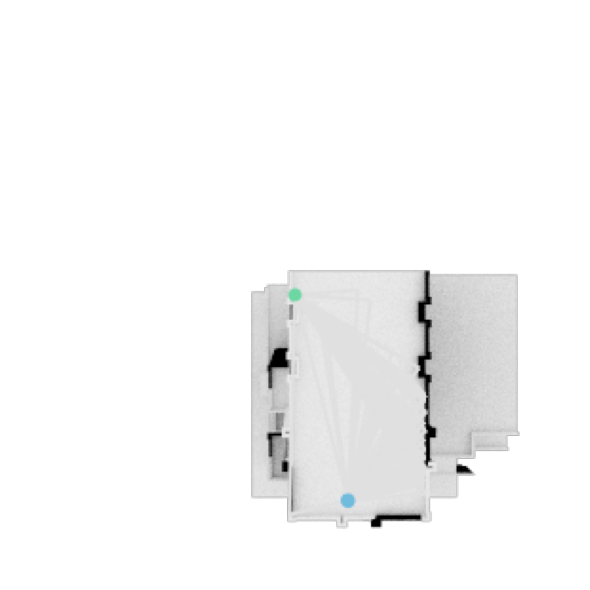

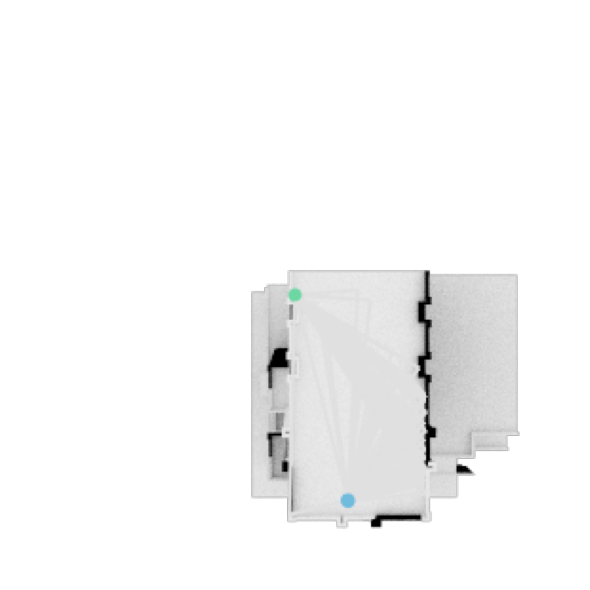

In [111]:
scene.render("cam", resolution=[300,300], num_samples=200, paths=paths)
# scene_simplification_3.render_to_file(camera="cam", filename="npzs_and_figures/scene_figures/scene" + str(i) + str(j) + ".png", paths=paths, resolution=[325, 250])